# JM0250 Data Visualization 
### Academic year 2022-2023

## FIFA World Cup 2022 Data Exploration
Data sources:

- FIFA World Cup 2022 Player Data (https://www.kaggle.com/datasets/swaptr/fifa-world-cup-2022-player-data)
- FIFA World Cup 2022 Match Data (https://www.kaggle.com/datasets/swaptr/fifa-world-cup-2022-match-data)
- FIFA World Cup 2022 Team Data (https://www.kaggle.com/datasets/swaptr/fifa-world-cup-2022-statistics)
- FIFA World Cup 2022 Twitter Dataset (https://www.kaggle.com/datasets/kumari2000/fifa-world-cup-twitter-dataset-2022)
- FIFA World Cup 2022 Prediction (https://www.kaggle.com/datasets/shilongzhuang/soccer-world-cup-challenge)
- FIFA World Cup 2022 Player Images (https://www.kaggle.com/datasets/soumendraprasad/fifa-2022-all-players-image-dataset)
- FIFA World Cup Historic (https://www.kaggle.com/datasets/piterfm/fifa-football-world-cup)
- FIFA World Cup Penalty Shootouts (https://www.kaggle.com/datasets/pablollanderos33/world-cup-penalty-shootouts, https://www.kaggle.com/datasets/jandimovski/world-cup-penalty-shootouts-2022)

Data dictionaries and additional info can be found in the respective data folders.

In [3]:
# Import libraries
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import os

# Do not truncate tables
pd.set_option('display.max_columns', None)

In [4]:
# Load the data

# Match data
df_match_data = pd.read_csv('../Data/FIFA World Cup 2022 Match Data/data.csv', delimiter=',')

# Player data
df_player_defense       = pd.read_csv('../Data/FIFA World Cup 2022 Player Data/player_defense.csv', delimiter=',')
df_player_gca           = pd.read_csv('../Data/FIFA World Cup 2022 Player Data/player_gca.csv', delimiter=',')
df_player_keepers       = pd.read_csv('../Data/FIFA World Cup 2022 Player Data/player_keepers.csv', delimiter=',')
df_player_keepersadv    = pd.read_csv('../Data/FIFA World Cup 2022 Player Data/player_keepersadv.csv', delimiter=',')
df_player_misc          = pd.read_csv('../Data/FIFA World Cup 2022 Player Data/player_misc.csv', delimiter=',')
df_player_passing       = pd.read_csv('../Data/FIFA World Cup 2022 Player Data/player_passing.csv', delimiter=',')
df_player_passing_types = pd.read_csv('../Data/FIFA World Cup 2022 Player Data/player_passing_types.csv', delimiter=',')
df_player_playingtime   = pd.read_csv('../Data/FIFA World Cup 2022 Player Data/player_playingtime.csv', delimiter=',')
df_player_possession    = pd.read_csv('../Data/FIFA World Cup 2022 Player Data/player_possession.csv', delimiter=',')
df_player_shooting      = pd.read_csv('../Data/FIFA World Cup 2022 Player Data/player_shooting.csv', delimiter=',')
df_player_stats         = pd.read_csv('../Data/FIFA World Cup 2022 Player Data/player_stats.csv', delimiter=',')

# Team data
df_team_data        = pd.read_csv('../Data/FIFA World Cup 2022 Team Data/team_data.csv', delimiter=',')
df_team_group_stats = pd.read_csv('../Data/FIFA World Cup 2022 Team Data/group_stats.csv', delimiter=',')

# Historic data
df_historic_fifa_ranking      = pd.read_csv('../Data/FIFA World Cup Historic/fifa_ranking_2022-10-06.csv', delimiter=',')
df_historic_matches_1930_2022 = pd.read_csv('../Data/FIFA World Cup Historic/matches_1930_2022.csv', delimiter=',')
df_historic_world_cup         = pd.read_csv('../Data/FIFA World Cup Historic/world_cup.csv', delimiter=',')

# Penalty shootouts
df_penalty_shootouts = pd.read_csv('../Data/FIFA World Cup Penalty Shootouts/WorldCupShootouts.csv', delimiter=',')

# Twitter data
df_tweets_01 = pd.read_csv('../Data/FIFA World Cup 2022 Twitter Dataset/tweets1.csv', delimiter=';')
df_tweets_02 = pd.read_csv('../Data/FIFA World Cup 2022 Twitter Dataset/tweets2.csv', delimiter=';')
df_tweets = pd.concat([df_tweets_01, df_tweets_02])

# Prediction data
df_prediction_groups  = pd.read_csv('../Data/FIFA World Cup 2022 Prediction/2022_world_cup_groups.csv', delimiter=',')
df_prediction_matches = pd.read_csv('../Data/FIFA World Cup 2022 Prediction/2022_world_cup_matches.csv', delimiter=',')
df_prediction_international_matches = pd.read_csv('../Data/FIFA World Cup 2022 Prediction/international_matches.csv', delimiter=',')
df_prediction_world_cup_matches = pd.read_csv('../Data/FIFA World Cup 2022 Prediction/world_cup_matches.csv', delimiter=',')
df_prediction_world_cups = pd.read_csv('../Data/FIFA World Cup 2022 Prediction/world_cups.csv', delimiter=',')

# Player images
def list_full_paths(directory):
    return [os.path.join(directory, file) for file in os.listdir(directory)]

def img_reshape(img):
    img = Image.open(img).convert('RGB')
    img = img.resize((300,300))
    img = np.asarray(img)
    return img

def showImages(group, land, player):
    images  = list_full_paths('../Data/FIFA World Cup 2022 Player Images/Images/Images/Group ' + group + '/' + land + ' Players/Images_' + player)
    img_arr = []
    
    for image in images:
        img_arr.append(img_reshape(image))
        
    rows = 5
    cols = 5
    img_count = 0
    fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=((5,5)))
                             
    for i in range(rows):
        for j in range(cols):
            if img_count < len(img_arr):
                axes[i,j].imshow(img_arr[img_count])
                axes[i,j].axis('off')
                img_count+=1
                
    plt.subplots_adjust(wspace=0, hspace=0)
    

In [4]:
## Explore Match data
df_match_data.head(5)

,match,dayofweek,match_time,home_team,away_team,home_xg,away_xg,score,attendance,venue,referee,home_formation,away_formation,home_captain,away_captain,home_manager,away_manager,home_possession,away_possession,home_completed_passes,home_attempted_pases,away_completed_passes,away_attempted_pases,home_sot,away_sot,home_total_shots,away_total_shots,home_saves,away_saves,home_fouls,away_fouls,home_corners,away_corners,home_crosses,away_crosses,home_touches,away_touches,home_tackles,away_tackles,home_interceptions,away_interceptions,home_aerials_won,away_aerials_won,home_clearances,away_clearances,home_offsides,away_offsides,home_gks,away_gks,home_throw_ins,away_throw_ins,home_long_balls,away_long_balls
0,1,Sun,2022-11-20 19:00:00,Qatar,Ecuador,0.3,1.2,0–2,67372,Al Bayt Stadium,Daniele Orsato,5-3-2,4-4-2,Hassan Al-Haydos,Enner Valencia,Félix Sánchez,Gustavo Alfaro,47,53,377,469,430,522,0,2,5,5,1,0,15,15,1,3,8,14,549,601,10,14,2,12,14,13,18,7,3,4,4,7,20,17,51,70
1,2,Mon,2022-11-21 16:00:00,England,IR Iran,2.1,1.4,6–2,45334,Khalifa International Stadium,Raphael Claus,4-2-3-1,5-4-1,Harry Kane,Ehsan Hajsafi,Gareth Southgate,Carlos Queiroz,77,23,740,838,162,248,7,2,13,7,1,1,9,14,8,0,21,8,922,341,13,12,7,16,10,10,4,23,2,2,5,5,18,17,87,50
2,3,Mon,2022-11-21 19:00:00,Senegal,Netherlands,0.9,0.7,0–2,41721,Al Thumama Stadium,Wilton Sampaio,4-2-3-1,3-4-1-2,Kalidou Koulibaly,Virgil van Dijk,Aliou Cissé,Louis van Gaal,46,54,333,427,387,494,4,3,15,10,1,4,13,13,6,7,19,25,531,573,14,10,10,6,22,20,32,16,2,1,6,10,17,28,64,66
3,4,Mon,2022-11-21 22:00:00,United States,Wales,0.8,1.5,1–1,43418,Ahmed bin Ali Stadium,Abdulrahman Ibrahim Al Jassim,4-3-3,3-5-2,Tyler Adams,Gareth Bale,Gregg Berhalter,Rob Page,58,42,524,624,335,446,1,2,6,6,2,0,15,10,5,3,30,14,724,568,14,18,6,8,14,12,18,31,1,1,5,10,22,25,56,90
4,5,Tue,2022-11-22 13:00:00,Argentina,Saudi Arabia,2.2,0.1,1–2,88012,Lusail Iconic Stadium,Slavko Vinčič,4-4-2,4-1-4-1,Lionel Messi,Salman Al-Faraj,Lionel Scaloni,Hervé Renard,69,31,546,659,195,294,5,2,14,3,0,5,7,21,9,2,23,10,753,411,17,18,9,14,16,7,11,26,10,1,3,9,24,13,55,59


In [5]:
df_match_data.describe()

,match,home_xg,away_xg,attendance,home_possession,away_possession,home_completed_passes,home_attempted_pases,away_completed_passes,away_attempted_pases,home_sot,away_sot,home_total_shots,away_total_shots,home_saves,away_saves,home_fouls,away_fouls,home_corners,away_corners,home_crosses,away_crosses,home_touches,away_touches,home_tackles,away_tackles,home_interceptions,away_interceptions,home_aerials_won,away_aerials_won,home_clearances,away_clearances,home_offsides,away_offsides,home_gks,away_gks,home_throw_ins,away_throw_ins,home_long_balls,away_long_balls
count,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000,64.000000
mean,32.500000,1.379687,1.270312,53191.437500,50.890625,49.109375,444.843750,545.765625,427.515625,529.265625,4.062500,3.437500,11.125000,11.265625,2.468750,2.640625,12.625000,12.343750,4.484375,4.437500,16.640625,17.375000,651.109375,633.062500,16.484375,15.843750,8.421875,8.296875,13.937500,13.093750,19.312500,18.203125,1.984375,1.984375,7.625000,7.500000,20.921875,19.765625,65.906250,65.125000
std,18.618987,0.889655,0.953636,17108.666048,12.744270,12.744270,156.147084,156.710403,165.301071,169.349572,2.455153,2.617857,4.952152,5.853346,2.189214,1.938476,5.244801,3.788951,2.777416,2.782456,8.241142,6.936217,151.298099,165.782117,4.649602,5.909956,3.517777,3.274140,5.258025,5.019703,9.098884,9.123804,1.741120,1.713552,3.359422,2.678545,6.347865,5.479376,14.937668,14.217695
min,1.000000,0.100000,0.000000,39089.000000,18.000000,19.000000,165.000000,245.000000,162.000000,248.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,3.000000,5.000000,0.000000,0.000000,2.000000,4.000000,356.000000,341.000000,8.000000,5.000000,2.000000,3.000000,6.000000,5.000000,4.000000,3.000000,0.000000,0.000000,0.000000,2.000000,9.000000,8.000000,41.000000,39.000000
25%,16.750000,0.700000,0.600000,42424.000000,41.750000,40.750000,332.750000,424.500000,322.500000,417.500000,2.750000,2.000000,8.000000,7.000000,1.000000,1.000000,9.000000,10.000000,2.000000,2.000000,11.000000,13.000000,526.750000,530.000000,13.000000,12.000000,7.000000,5.000000,10.000000,10.000000,12.750000,12.000000,1.000000,1.000000,5.750000,5.000000,16.000000,15.000000,55.000000,55.750000
50%,32.500000,1.250000,1.100000,44093.000000,53.000000,47.000000,446.500000,552.500000,396.500000,494.000000,4.000000,3.000000,10.000000,10.500000,2.000000,2.000000,13.000000,12.000000,4.500000,4.000000,16.500000,16.000000,652.500000,604.000000,16.000000,14.500000,8.000000,8.000000,13.500000,12.000000,19.000000,17.000000,2.000000,2.000000,7.000000,8.000000,21.000000,20.000000,64.000000,64.000000
75%,48.250000,1.825000,1.700000,66851.500000,59.250000,58.250000,532.250000,630.750000,509.500000,612.500000,6.000000,5.000000,14.000000,13.000000,3.250000,4.000000,15.000000,14.250000,6.000000,6.000000,22.000000,21.250000,735.750000,702.750000,20.250000,19.000000,10.000000,11.000000,18.000000,15.000000,24.000000,22.250000,3.000000,3.000000,9.000000,10.000000,24.000000,23.250000,74.750000,75.000000
max,64.000000,4.000000,5.700000,88966.000000,81.000000,82.000000,1009.000000,1093.000000,995.000000,1106.000000,10.000000,11.000000,25.000000,32.000000,10.000000,8.000000,30.000000,24.000000,12.000000,14.000000,46.000000,35.000000,1179.000000,1190.000000,28.000000,37.000000,19.000000,16.000000,26.000000,33.000000,45.000000,50.000000,10.000000,7.000000,18.000000,13.000000,40.000000,33.000000,99.000000,106.000000


In [6]:
# Remove penalty data from score
df_match_data['score'] = df_match_data['score'].str.replace(r"\(.\)","")
           
# Split match score               
df_match_data[['score_home', 'score_away']] = df_match_data.score.str.split("–", expand=True,)
# df_match_data['score_home'] = df_match_data['score_home'].str.replace(" ","").astype('int')
# df_match_data['score_away'] = df_match_data['score_away'].str.replace(" ","").astype('int')

fig = px.scatter(df_match_data, x="home_possession", y="score_home",
                 color="venue", size="attendance",
                 width=1000, height=800)
fig.show()

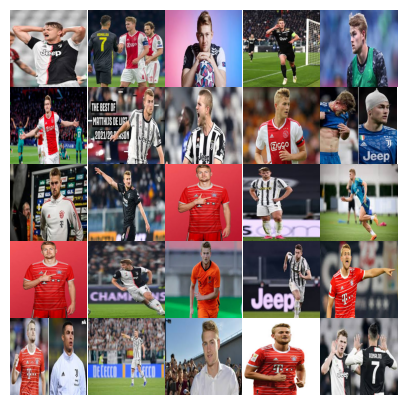

In [7]:
showImages('A', 'Netherlands', 'Matthijs de Ligt')

In [26]:
df_team_data

,team,players_used,avg_age,possession,games,games_starts,minutes,minutes_90s,goals,assists,goals_pens,pens_made,pens_att,cards_yellow,cards_red,goals_per90,assists_per90,goals_assists_per90,goals_pens_per90,goals_assists_pens_per90,xg,npxg,xg_assist,npxg_xg_assist,xg_per90,xg_assist_per90,xg_xg_assist_per90,npxg_per90,npxg_xg_assist_per90,gk_games,gk_games_starts,gk_minutes,gk_goals_against,gk_goals_against_per90,gk_shots_on_target_against,gk_saves,gk_save_pct,gk_wins,gk_ties,gk_losses,gk_clean_sheets,gk_clean_sheets_pct,gk_pens_att,gk_pens_allowed,gk_pens_saved,gk_pens_missed,gk_pens_save_pct,gk_free_kick_goals_against,gk_corner_kick_goals_against,gk_own_goals_against,gk_psxg,gk_psnpxg_per_shot_on_target_against,gk_psxg_net,gk_psxg_net_per90,gk_passes_completed_launched,gk_passes_launched,gk_passes_pct_launched,gk_passes,gk_passes_throws,gk_pct_passes_launched,gk_passes_length_avg,gk_goal_kicks,gk_pct_goal_kicks_launched,gk_goal_kick_length_avg,gk_crosses,gk_crosses_stopped,gk_crosses_stopped_pct,gk_def_actions_outside_pen_area,gk_def_actions_outside_pen_area_per90,gk_avg_distance_def_actions,shots,shots_on_target,shots_on_target_pct,shots_per90,shots_on_target_per90,goals_per_shot,goals_per_shot_on_target,average_shot_distance,shots_free_kicks,npxg_per_shot,xg_net,npxg_net,passes_completed,passes,passes_pct,passes_total_distance,passes_progressive_distance,passes_completed_short,passes_short,passes_pct_short,passes_completed_medium,passes_medium,passes_pct_medium,passes_completed_long,passes_long,passes_pct_long,pass_xa,xg_assist_net,assisted_shots,passes_into_final_third,passes_into_penalty_area,crosses_into_penalty_area,progressive_passes,passes_live,passes_dead,passes_free_kicks,through_balls,passes_switches,crosses,throw_ins,corner_kicks,corner_kicks_in,corner_kicks_out,corner_kicks_straight,passes_offsides,passes_blocked,sca,sca_per90,sca_passes_live,sca_passes_dead,sca_dribbles,sca_shots,sca_fouled,sca_defense,gca,gca_per90,gca_passes_live,gca_passes_dead,gca_dribbles,gca_shots,gca_fouled,gca_defense,tackles,tackles_won,tackles_def_3rd,tackles_mid_3rd,tackles_att_3rd,dribble_tackles,dribbles_vs,dribble_tackles_pct,dribbled_past,blocks,blocked_shots,blocked_passes,interceptions,tackles_interceptions,clearances,errors,touches,touches_def_pen_area,touches_def_3rd,touches_mid_3rd,touches_att_3rd,touches_att_pen_area,touches_live_ball,dribbles_completed,dribbles,dribbles_completed_pct,miscontrols,dispossessed,passes_received,progressive_passes_received,minutes_per_game,minutes_pct,minutes_per_start,games_complete,games_subs,minutes_per_sub,unused_subs,points_per_game,on_goals_for,on_goals_against,plus_minus,plus_minus_per90,on_xg_for,on_xg_against,xg_plus_minus,xg_plus_minus_per90,cards_yellow_red,fouls,fouled,offsides,pens_won,pens_conceded,own_goals,ball_recoveries,aerials_won,aerials_lost,aerials_won_pct
0,Argentina,24,28.4,57.4,7,77,690,7.7,15,8,11,4,5,17,0,1.96,1.04,3.00,1.43,2.48,15.2,11.4,7.8,19.3,1.98,1.02,3.00,1.49,2.51,7,7,690,8,1.04,13,6,53.8,4,2,1,3,42.9,2,2,0,0,0.0,0,0,1,5.4,0.26,-1.6,-0.21,15,78,19.2,147,34,38.8,34.4,39,53.8,46.0,87,12,13.8,4,0.52,12.1,95,41,43.2,12.39,5.35,0.12,0.27,18.3,3,0.12,-0.2,-0.4,3911,4625,84.6,60635,18633,2131,2336,91.2,1453,1636,88.8,233,431,54.1,7.1,0.2,76,242,64,7,217,4237,365,119,10,21,94,151,39,11,17,0,23,62,179,23.35,134,13,6,9,10,7,25,3.26,16,1,3,1,4,0,123,69,70,41,12,59,100,59.0,41,84,14,70,52,175,124,0,5388,352,1424,2716,1293,157,5383,45,112,40.2,99,81,3868,210,99,100,87,41,36,24,66,2.00,15,8,7,0.91,15.2,4.6,10.6,1.38,0,100,115,23,5,2,1,357,83,90,48.0
1,Australia,20,28.7,37.8,4,44,360,4.0,3,3,3,0,0,7,0,0.75,0.75,1.50,0.75,1.50,2.3,2.3,1.9,4.2,0.58,0.48,1.06,0.58,1.06,4,4,360,6,1.50,18,12,66.7,2,0,2,2,50.0,0,0,0,0,-1.0,0,1,0,5.5,0.31,-0.5,-0.13,38,85,44.7,127,13,50.4,38.5,37,56.8,46.2,63,3,4.8,6,1.50,15.5,26,8,30.8,6.50,2.00,0.12,0.38,18.5,0,0.09,0.7,0.7,1254,1696,73.9,22489,8922,546,643,84.9,499,612,81.5,145,306,47.4,1.1,1.1,17,77,15,2,68,1493,202,48,1,13,54,98,8,3,5,0,1,41,

In [31]:
def read_data_position(df, column, row):
    cols = df.columns.values.tolist()
    return df.loc[row, cols[column]]

In [33]:
data = read_data_position(df_team_data, 0, 1)
data

'Australia'

In [45]:
def value_count_attribute(df, attribute):
    print(df[attribute].value_counts())
    print(f"distribution of {attribute} is: {df[attribute].max()} - {df[attribute].min()}")

In [46]:
value_count_attribute(df_team_data, 'players_used')

players_used
20    9
21    8
24    4
22    4
19    2
18    2
26    1
25    1
23    1
Name: count, dtype: int64
distribution of players_used is: 26 - 18


In [24]:
df_team_data.columns.values, df_team_data.columns.values.shape

(array(['team', 'players_used', 'avg_age', 'possession', 'games',
        'games_starts', 'minutes', 'minutes_90s', 'goals', 'assists',
        'goals_pens', 'pens_made', 'pens_att', 'cards_yellow', 'cards_red',
        'goals_per90', 'assists_per90', 'goals_assists_per90',
        'goals_pens_per90', 'goals_assists_pens_per90', 'xg', 'npxg',
        'xg_assist', 'npxg_xg_assist', 'xg_per90', 'xg_assist_per90',
        'xg_xg_assist_per90', 'npxg_per90', 'npxg_xg_assist_per90',
        'gk_games', 'gk_games_starts', 'gk_minutes', 'gk_goals_against',
        'gk_goals_against_per90', 'gk_shots_on_target_against', 'gk_saves',
        'gk_save_pct', 'gk_wins', 'gk_ties', 'gk_losses',
        'gk_clean_sheets', 'gk_clean_sheets_pct', 'gk_pens_att',
        'gk_pens_allowed', 'gk_pens_saved', 'gk_pens_missed',
        'gk_pens_save_pct', 'gk_free_kick_goals_against',
        'gk_corner_kick_goals_against', 'gk_own_goals_against', 'gk_psxg',
        'gk_psnpxg_per_shot_on_target_against', 'g

In [9]:
df_tweets.head()

,Tweet Id,Tweet URL,Tweet Posted Time,Tweet Content,Tweet Type,Client,Retweets Received,Likes Received,Tweet Location,Tweet Language,User Id,Name,Username,User Bio,Verified or Non-Verified,Profile URL,User Followers,User Following,User Account Creation Date
0,"""1603309229871452160""",https://twitter.com/imrmkhan1/status/160330922...,15 Dec 2022 08:41:23,"""Field par Messi aur Mbappe… studio mein @Wayn...",ReTweet,"""Twitter for Android""",0,0,"""""",Hindi,"""1584973275628699648""","""iamrmkhan""",imrmkhan1,"""""",Non-Verified,https://twitter.com/imrmkhan1,11,12,25-Oct-2022 18:21:42
1,"""1603309229980487681""",https://twitter.com/Shahxaze1/status/160330922...,15 Dec 2022 08:41:23,"""𝐈𝐭. 𝐂𝐚𝐧𝐧𝐨𝐭. 𝐆𝐞𝐭. 𝐁𝐢𝐠𝐠𝐞𝐫. 𝐓𝐡𝐚𝐧. 𝐓𝐡𝐢𝐬. 🔥\n\nGet...",ReTweet,"""Twitter for iPhone""",0,0,"""""",English,"""1558508894925869056""","""Shahxaze""",Shahxaze1,"""Shah Rukh Khan Aze 🇦🇿""",Non-Verified,https://twitter.com/Shahxaze1,247,232,13-Aug-2022 17:41:00
2,"""1603309226469642240""",https://twitter.com/SorareAlexandre/status/160...,15 Dec 2022 08:41:22,"""🎁 CONCOURS SORARE 🎁\n\nJOUEUR À GAGNER : SEKO...",ReTweet,"""Twitter for Android""",0,0,"""""",French,"""1592150953871958016""","""Pawastyle45""",SorareAlexandre,"""Je viens de découvrir Sorare et je surkiffe. ...",Non-Verified,https://twitter.com/SorareAlexandre,18,154,14-Nov-2022 13:42:50
3,"""1603309226604236800""",https://twitter.com/Woozie178/status/160330922...,15 Dec 2022 08:41:22,"""It’ll be a tough night for Europe today.\n\n#...",ReTweet,"""Twitter for Android""",0,0,"""""",English,"""1492945970295808003""","""Woozie""",Woozie178,"""Truth seeker, nationalist, engineer, gamer""",Non-Verified,https://twitter.com/Woozie178,19,131,13-Feb-2022 19:37:47
4,"""1603309227392618496""",https://twitter.com/thug_boiiii/status/1603309...,15 Dec 2022 08:41:22,"""In defeat or in victory, always say Alhamduli...",ReTweet,"""Twitter for Android""",0,0,"""""",English,"""999001409231212544""","""Itx_madan 🇵🇰💪🇵🇸""",thug_boiiii,"""Content Creator.......https://www.instagram.c...",Non-Verified,https://twitter.com/thug_boiiii,803,778,22-May-2018 18:57:51


In [18]:
df_viewership  = pd.read_csv('../Data/FIFA World Cup 2022 Viewership/FIFA World Cup Global Audience Reach.csv', delimiter=',')
df_women_matches_1991_2023  = pd.read_csv('../Data/FIFA Womens World Cup Dataset/matches_1991_2023.csv', delimiter=',')
df_women_world_cup  = pd.read_csv('../Data/FIFA Womens World Cup Dataset/womens-world-cup.csv', delimiter=',')

In [11]:
df_viewership.head()

,Year,Hosts,Total_Attendance,Matches,Global_Reach,Global_Consecutive,Finals_Reach,Finals_Consecutive
0,2002,South Korea Japan,2705197,64,1.500000e+09,NaN,1100000000,NaN
1,2006,Germany,3359439,64,2.978360e+09,2.156611e+09,871060228,592464845.0
2,2010,South Africa,3178856,64,3.203443e+09,2.211577e+09,909566803,619709456.0
3,2014,Brazil,3429873,64,3.190800e+09,2.130000e+09,1013000000,695000000.0
4,2018,Russia,3031768,64,3.572000e+09,2.650000e+09,1116900000,NaN


In [13]:
df_historic_fifa_ranking.head()

,team,team_code,association,rank,previous_rank,points,previous_points
0,Brazil,BRA,CONMEBOL,1,1,1841.30,1837.56
1,Belgium,BEL,UEFA,2,2,1816.71,1821.92
2,Argentina,ARG,CONMEBOL,3,3,1773.88,1770.65
3,France,FRA,UEFA,4,4,1759.78,1764.85
4,England,ENG,UEFA,5,5,1728.47,1737.46


In [16]:
df_historic_matches_1930_2022.head()

,home_team,away_team,home_score,home_xg,home_penalty,away_score,away_xg,away_penalty,home_manager,home_captain,away_manager,away_captain,Attendance,Venue,Officials,Round,Date,Score,Referee,Notes,Host,Year,home_goal,away_goal,home_goal_long,away_goal_long,home_own_goal,away_own_goal,home_penalty_goal,away_penalty_goal,home_penalty_miss_long,away_penalty_miss_long,home_penalty_shootout_goal_long,away_penalty_shootout_goal_long,home_penalty_shootout_miss_long,away_penalty_shootout_miss_long,home_red_card,away_red_card,home_yellow_red_card,away_yellow_red_card,home_yellow_card_long,away_yellow_card_long,home_substitute_in_long,away_substitute_in_long
0,Argentina,France,3,3.3,4.0,3,2.2,2.0,Lionel Scaloni,Lionel Messi,Didier Deschamps,Hugo Lloris,88966,"Lusail Iconic Stadium, Lusail",Szymon Marciniak (Referee) · Paweł Sokolnicki ...,Final,2022-12-18,(4) 3–3 (2),Szymon Marciniak,Argentina won on penalty kicks following extra...,Qatar,2022,Ángel Di María · 36|Lionel Messi · 108,Kylian Mbappé · 81,['36&rsquor;|2:0|Ángel Di María|Assist:|Alexis...,['81&rsquor;|2:2|Kylian Mbappé|Assist:|Marcus ...,NaN,NaN,Lionel Messi (P) · 23,Kylian Mbappé (P) · 80|Kylian Mbappé (P) · 118,NaN,NaN,"['2|1:1|Lionel Messi', '4|2:1|Paulo Dybala', '...","['1|0:1|Kylian Mbappé', '7|3:2|Randal Kolo Mua...",NaN,"['3|1:1|Kingsley Coman', '5|2:1|Aurélien Tchou...",NaN,NaN,NaN,NaN,"['45+7&rsquor;|2:0|Enzo Fernández', '90+8&rsqu...","['55&rsquor;|2:0|Adrien Rabiot', '87&rsquor;|2...",['64&rsquor;|2:0|Marcos Acuña|for Ángel Di Mar...,['41&rsquor;|2:0|Randal Kolo Muani|for Ousmane...
1,Croatia,Morocco,2,0.7,NaN,1,1.2,NaN,Zlatko Dalić,Luka Modrić,Hoalid Regragui,Hakim Ziyech,44137,"Khalifa International Stadium, Doha",Abdulrahman Ibrahim Al Jassim (Referee) · Tale...,Third-place match,2022-12-17,2–1,Abdulrahman Ibrahim Al Jassim,NaN,Qatar,2022,Joško Gvardiol · 7|Mislav Oršić · 42,Achraf Dari · 9,['7&rsquor;|1:0|Joško Gvardiol|Assist:|Ivan Pe...,['9&rsquor;|1:1|Achraf Dari'],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"['69&rsquor;|2:1|Azzedine Ounahi', '84&rsquor;...",['61&rsquor;|2:1|Nikola Vlašić|for Andrej Kram...,['46&rsquor;|2:1|Ilias Chair|for Abdelhamid Sa...
2,France,Morocco,2,2.0,NaN,0,0.9,NaN,Didier Deschamps,Hugo Lloris,Hoalid Regragui,Romain Saïss,68294,"Al Bayt Stadium, Al Khor",César Arturo Ramos (Referee) · Alberto Morín (...,Semi-finals,2022-12-14,2–0,César Arturo Ramos,NaN,Qatar,2022,Theo Hernández · 5|Randal Kolo Muani · 79,NaN,"['5&rsquor;|1:0|Theo Hernández', '79&rsquor;|2...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,['27&rsquor;|1:0|Sofiane Boufal'],['65&rsquor;|1:0|Marcus Thuram|for Olivier Gir...,['21&rsquor;|1:0|Selim Amallah|for Romain Saïs...
3,Argentina,Croatia,3,2.3,NaN,0,0.5,NaN,Lionel Scaloni,Lionel Messi,Zlatko Dalić,Luka Modrić,88966,"Lusail Iconic Stadium, Lusail",Daniele Orsato (Referee) · Ciro Carbone (AR1) ...,Semi-finals,2022-12-13,3–0,Daniele Orsato,NaN,Qatar,2022,Julián Álvarez · 39|Julián Álvarez · 69,NaN,"['39&rsquor;|2:0|Julián Álvarez', '69&rsquor;|...",NaN,NaN,NaN,Lionel Messi (P) · 34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"['68&rsquor;|2:0|Cristian Romero', '71&rsquor;...","['32&rsquor;|0:0|Mateo Kovačić', '32&rsquor;|0...",['62&rsquor;|2:0|Lisandro Martínez|for Leandro...,"['46&rsquor;|2:0|Mislav Oršić|for Borna Sosa',..."
4,Morocco,Portugal,1,1.4,NaN,0,0.9,NaN,Hoalid Regragui,Romain Saïss,Fernando Santos,Pepe,44198,"Al Thumama Stadium, ath-Thumāma",Facundo Tello (Referee) · Ezequiel Brailovsky ...,Quarter-finals,2022-12-10,1–0,Facundo Tello,NaN,Qatar,2022,Youssef En-Nesyri · 42,NaN,['42&rsquor;|1:0|Youssef En-Nesyri|Assist:|Yah...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Walid Cheddira · 90+3,NaN,"['70&rsquor;|1:0|Achraf Dari', '90+1&rsquor;|1...",['87&rsquor;|1:0|Vitinha'],['57&rsquor;|1:0|Achraf Dari|for Romain Saïss'...,['51&rsquor;|1:0|João Cancelo|for Raphaël Guer...


In [15]:
df_historic_world_cup

,Year,Host,Teams,Champion,Runner-Up,TopScorrer,Attendance,AttendanceAvg,Matches
0,2022,Qatar,32,Argentina,France,Kylian Mbappé - 8,3404252,53191,64
1,2018,Russia,32,France,Croatia,Harry Kane - 6,3031768,47371,64
2,2014,Brazil,32,Germany,Argentina,James Rodríguez - 6,3429873,53592,64
3,2010,South Africa,32,Spain,Netherlands,"Wesley Sneijder, Thomas Müller... - 5",3178856,49670,64
4,2006,Germany,32,Italy,France,Miroslav Klose - 5,3352605,52384,64
5,2002,"Korea Republic, Japan",32,Brazil,Germany,Ronaldo - 8,2705337,42271,64
6,1998,France,32,France,Brazil,Davor Šuker - 6,2903477,45367,64
7,1994,United States,24,Brazil,Italy,"Hristo Stoichkov, Oleg Salenko - 6",3587538,68991,52
8,1990,Italy,24,West Germany,Argentina,Salvatore Schillaci - 6,2516215,48389,52
9,1986,Mexico,24,Argentina,West Germany,Gary Lineker - 6,2394031,46039,52


In [19]:
df_women_matches_1991_2023.head()

,home_team,away_team,home_score,home_xg,home_penalty,away_score,away_xg,away_penalty,home_manager,home_captain,away_manager,away_captain,Attendance,Venue,Officials,Round,Date,Score,Referee,Notes,Host,Year,home_goal,away_goal,home_goal_long,away_goal_long,home_own_goal,away_own_goal,home_penalty_goal,away_penalty_goal,home_penalty_miss_long,away_penalty_miss_long,home_penalty_shootout_goal_long,away_penalty_shootout_goal_long,home_penalty_shootout_miss_long,away_penalty_shootout_miss_long,home_red_card,away_red_card,home_yellow_red_card,away_yellow_red_card,home_yellow_card_long,away_yellow_card_long,home_substitute_in_long,away_substitute_in_long
0,Spain,England,1,2.1,NaN,0,0.5,NaN,Jorge Vilda,Olga Carmona,Sarina Wiegman,Millie Bright,75784,"Accor Stadium, Sydney",Tori Penso (Referee) · Brooke Mayo (AR1) · Kat...,Final,2023-08-20,1–0,Tori Penso,NaN,"Australia, New Zealand",2023,Olga Carmona · 29’,NaN,['29’|1:0|Olga Carmona|Assist:|Mariona Caldent...,NaN,NaN,NaN,NaN,NaN,['69’|1:0|Jennifer Hermoso|Penalty saved by Ma...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,['78’|1:0|Salma Paralluelo'],['55’|1:0|Lauren Hemp'],"['60’|1:0|Oihane Hernández|for Alba Redondo', ...","['46’|1:0|Lauren James|for Alessia Russo', '46..."
1,Sweden,Australia,2,1.8,NaN,0,0.8,NaN,Peter Gerhardsson,Kosovare Asllani,Tony Gustavsson,Sam Kerr,49461,"Suncorp Stadium, Brisbane",NaN,Third-place match,2023-08-19,2–0,NaN,NaN,"Australia, New Zealand",2023,Kosovare Asllani · 62’,NaN,['62’|2:0|Kosovare Asllani|Assist:|Stina Black...,NaN,NaN,NaN,Fridolina Rolfö (P) · 30’,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"['88’|2:0|Elin Rubensson', '90+5’|2:0|Lina Hur...",['45+1’|1:0|Katrina Gorry'],['67’|2:0|Rebecka Blomqvist|for Stina Blackste...,"['60’|1:0|Cortnee Vine|for Hayley Raso', '60’|..."
2,Australia,England,1,1.4,NaN,3,1.3,NaN,Tony Gustavsson,Sam Kerr,Sarina Wiegman,Millie Bright,75784,"Accor Stadium, Sydney",Tori Penso (Referee) · Brooke Mayo (AR1) · Mij...,Semi-finals,2023-08-16,1–3,Tori Penso,NaN,"Australia, New Zealand",2023,Sam Kerr · 63’,Ella Toone · 36’|Lauren Hemp · 71’|Alessia Rus...,['63’|1:1|Sam Kerr|Assist:|Katrina Gorry'],"['36’|0:1|Ella Toone', '71’|1:2|Lauren Hemp|As...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"['10’|0:0|Alex Greenwood', '90+5’|1:3|Chloe Ke...","['72’|1:2|Cortnee Vine|for Hayley Raso', '81’|...","['87’|1:3|Chloe Kelly|for Alessia Russo', '90’..."
3,Spain,Sweden,2,1.6,NaN,1,0.9,NaN,Jorge Vilda,Olga Carmona,Peter Gerhardsson,Kosovare Asllani,43217,"Eden Park, Auckland",Edina Alves Batista (Referee) · Neuza Back (AR...,Semi-finals,2023-08-15,2–1,Edina Alves Batista,NaN,"Australia, New Zealand",2023,Salma Paralluelo · 81’|Olga Carmona · 89’,Rebecka Blomqvist · 88’,"['81’|1:0|Salma Paralluelo', '89’|2:1|Olga Car...",['88’|1:1|Rebecka Blomqvist|Assist:|Lina Hurtig'],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,['57’|0:0|Salma Paralluelo|for Alexia Putellas...,['77’|0:0|Rebecka Blomqvist|for Stina Blackste...
4,Australia,France,0,1.6,7.0,0,2.0,6.0,Tony Gustavsson,Steph Catley,Hervé Renard,Wendie Renard,49461,"Suncorp Stadium, Brisbane",María Carvajal (Referee) · Leslie Vásquez (AR1...,Quarter-finals,2023-08-12,(7) 0–0 (6),María Carvajal,Australia won on penalty kicks following extra...,"Australia, New Zealand",2023,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"['2|1:0|Caitlin Foord', '6|2:2|Sam Kerr', '8|3...","['3|1:1|Kadidiatou Diani', '5|1:2|Wendie Renar...","['4|1:1|Steph Catley', '10|3:3|Mackenzie Arnol...","['1|0:0|Selma Bacha', '9|3:3|Ève Périsset', '1...",NaN,NaN,NaN,NaN,['92’|0:0|Katrina Gorry'],NaN,"['55’|0:0|Sam Kerr|for Emily van Egmond', '104...","['64’|0:0|Vicki Bècho|for Sandie Toletti', '12..."


In [20]:
df_women_world_cup.head()

,id,squad,year,players,age,possesion,matches_played,starts,min_playing_time,minutes_played_90s,goals,assists,non_penalty_goals,penalty_kicks_made,penalty_kicks_attempted,yellow_cards,red_cards,goals_per_90,assists_per_90,goals_plus_assists_per_90,goals_minus_penalty_kicks_per_90,goals_plus_assists_minus_penalty_kicks_per_90
0,1,Argentina,2019,18,26.8,34.7,3,33,270,3.0,2,1,1,1,1,3.0,0.0,0.67,0.33,1.00,0.33,0.67
1,2,Australia,2019,18,25.4,61.3,4,44,390,4.3,8,4,8,0,1,2.0,0.0,1.85,0.92,2.77,1.85,2.77
2,3,Brazil,2019,18,29.7,51.5,4,44,390,4.3,7,3,5,2,3,7.0,0.0,1.62,0.69,2.31,1.15,1.85
3,4,Cameroon,2019,20,27.7,36.0,4,44,360,4.0,3,3,3,0,0,6.0,0.0,0.75,0.75,1.50,0.75,1.50
4,5,Canada,2019,16,27.0,63.0,4,44,360,4.0,4,3,4,0,1,2.0,0.0,1.00,0.75,1.75,1.00,1.75


In [5]:
def nan_values(df: pd.DataFrame):
    cols = df.columns.values.tolist()
    rows = df.index.values.tolist()
    for col in cols:
        if df[col].isna().sum() == 0:
            pass
        else:
            print(f"for {col}: {df[col].isna().sum()} NaN values")
    for row in rows:
        row_nans = df.isnull().sum(axis=1).tolist()
        for i, row_nan_item in enumerate(row_nans):
            if row_nan_item == 0:
                pass
            else:
                print(f"for row {i}: {row_nan_item} NaN values")

In [6]:
nan_values(df_tweets)

for Tweet Language: 3722 NaN values
for row 409: 1 NaN values
for row 485: 1 NaN values
for row 491: 1 NaN values
for row 692: 1 NaN values
for row 703: 1 NaN values
for row 901: 1 NaN values
for row 1072: 1 NaN values
for row 1104: 1 NaN values
for row 1118: 1 NaN values
for row 1165: 1 NaN values
for row 1210: 1 NaN values
for row 1288: 1 NaN values
for row 1392: 1 NaN values
for row 1427: 1 NaN values
for row 1730: 1 NaN values
for row 1735: 1 NaN values
for row 1785: 1 NaN values
for row 1794: 1 NaN values
for row 1977: 1 NaN values
for row 1979: 1 NaN values
for row 2023: 1 NaN values
for row 2279: 1 NaN values
for row 2413: 1 NaN values
for row 2447: 1 NaN values
for row 2492: 1 NaN values
for row 2540: 1 NaN values
for row 2575: 1 NaN values
for row 2731: 1 NaN values
for row 2782: 1 NaN values
for row 2864: 1 NaN values
for row 3042: 1 NaN values
for row 3155: 1 NaN values
for row 3169: 1 NaN values
for row 3461: 1 NaN values
for row 3474: 1 NaN values
for row 3478: 1 NaN value

KeyboardInterrupt: 